In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.neighbors import KernelDensity
from scipy.stats import gaussian_kde
import folium
from folium.plugins import HeatMap
from esda.moran import Moran_Local
from libpysal.weights import Queen
import geopandas as gpd

In [41]:
df = pd.read_csv("C:/Users/hasan/Main/Accident_Project/us_datasets/US_Accidents_March23.csv")

In [43]:
df.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [45]:
coords = np.array(df[['Start_Lat', 'Start_Lng']])

In [47]:
def kdeAlgorithm(kernel_algorithm:list, bandwidth, coords, buffer, resolution, cmap, color, marker_size):
    """
    Perform Kernel Density Estimation (KDE) with specified algorithms and visualize results using contour maps.
    Belirtilen algoritmalarla Kernel Yoğunluk Tahmini (KDE) yapar ve sonuçları kontur haritalarıyla görselleştirir.
    
    Parameters:
    - kernel_algorithm (list): List of kernel algorithms to use (e.g., ['gaussian', 'epanechnikov']).
                               Kullanılacak çekirdek algoritmaların listesi (örneğin, ['gaussian', 'epanechnikov']).
    - bandwidth (float): Bandwidth for KDE, controls smoothness of the density estimation.
                         KDE için bant genişliği, yoğunluk tahmininin yumuşaklığını kontrol eder.
    - coords (numpy.ndarray): Coordinates (longitude, latitude) for the points to analyze.
                              Analiz edilecek noktaların koordinatları (boylam, enlem).
    - buffer (float): Buffer value to extend the grid beyond the data points.
                      Grid'i veri noktalarının ötesine genişletmek için tampon değeri.
    - resolution (int): Number of grid points along each axis, determines detail of the map.
                        Her eksen boyunca grid noktalarının sayısı, haritanın detayını belirler.
    - cmap (str): Colormap for the density plot (e.g., 'viridis', 'plasma').
                  Yoğunluk grafiği için renk haritası (örneğin, 'viridis', 'plasma').
    - color (str): Color for the data points on the scatter plot.
                   Dağılım grafiğindeki veri noktalarının rengi.
    - marker_size (float): Size of the markers for data points.
                           Veri noktaları için işaretçilerin boyutu.
    """
    
    # Iterate over each kernel algorithm in the list
    # Liste içindeki her çekirdek algoritma için döngü
    for algorithm in kernel_algorithm:
        
        # Fit the KDE model with the specified kernel and bandwidth
        # Belirtilen çekirdek ve bant genişliği ile KDE modelini oluştur
        kde = KernelDensity(kernel=algorithm, bandwidth=bandwidth).fit(coords)
        
        # Define the grid boundaries with the buffer
        # Tampon değeri ile grid sınırlarını tanımla
        x_min, x_max = coords[:, 0].min() - buffer, coords[:, 0].max() + buffer
        y_min, y_max = coords[:, 1].min() - buffer, coords[:, 1].max() + buffer
        
        # Create a 2D grid for KDE evaluation
        # KDE değerlendirmesi için 2D grid oluştur
        x_grid, y_grid = np.meshgrid(
            np.linspace(x_min, x_max, resolution),  # X-axis grid points
            np.linspace(y_min, y_max, resolution)   # Y-axis grid points
        )
        
        # Flatten the grid into an array of points for KDE input
        # KDE girdisi için grid'i bir dizi nokta haline getir
        grid_points = np.vstack([x_grid.ravel(), y_grid.ravel()]).T
        
        # Compute the log density on the grid points
        # Grid noktalarında log yoğunluğu hesapla
        log_density = kde.score_samples(grid_points)
        
        # Convert log density to standard density and reshape to grid size
        # Log yoğunluğu standart yoğunluğa çevir ve grid boyutuna yeniden şekillendir
        density = np.exp(log_density).reshape(resolution, resolution)
        
        # Plot the density as a contour map
        # Yoğunluğu bir kontur haritası olarak çiz
        plt.figure(figsize=(10, 8))
        plt.contourf(x_grid, y_grid, density, cmap=cmap)
        
        # Add a color bar to show density levels
        # Yoğunluk seviyelerini göstermek için bir renk çubuğu ekle
        plt.colorbar(label='Density / Yoğunluk')
        
        # Scatter plot of original data points
        # Orijinal veri noktalarının dağılım grafiği
        plt.scatter(coords[:, 0], coords[:, 1], c=color, s=marker_size, label='Data Points / Veri Noktaları')
        
        # Title of the plot includes the kernel algorithm used
        # Grafiğin başlığı kullanılan çekirdek algoritmasını içerir
        plt.title(f'Matplotlib Contour Map with KDE ({algorithm})')
        plt.xlabel('Longitude / Boylam')
        plt.ylabel('Latitude / Enlem')
        
        # Add a legend to describe the data points
        # Veri noktalarını açıklamak için bir açıklama ekle
        plt.legend()
        
        # Display the plot
        # Grafiği göster
        plt.show()


C:\Users\hasan\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


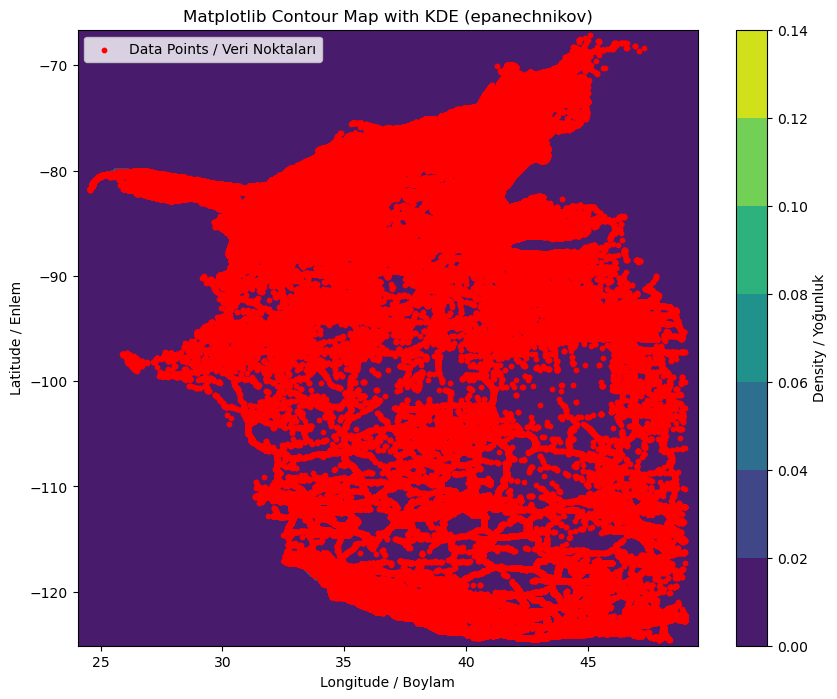

In [13]:
kdeAlgorithm(["epanechnikov"],0.5,coords,0.5,100,"viridis","red",10)

In [49]:
def anselin_morans_i_analysis_by_city(df, city_column, lat_column, lng_column, top_n=10, figsize=(10, 8)):
    """
    Perform Anselin Local Moran's I analysis on the top N cities by accident count and visualize the results.
    En çok kazaya sahip N şehirde Anselin Yerel Moran's I analizini gerçekleştirir ve sonuçları görselleştirir.

    Parameters:
    - df (DataFrame): Input dataset containing accident data / Kaza verilerini içeren veri seti.
    - city_column (str): Column name for cities / Şehirlerin sütun adı.
    - lat_column (str): Column name for latitude / Enlemin sütun adı.
    - lng_column (str): Column name for longitude / Boylamın sütun adı.
    - top_n (int): Number of top cities to analyze / Analiz edilecek en çok kaza yapan şehir sayısı.
    - figsize (tuple): Size of the output plot / Çıktı grafiğinin boyutu.

    Returns:
    - gdf (GeoDataFrame): GeoDataFrame with calculated categories / Hesaplanmış kategorilerle GeoDataFrame.
    - ax: Matplotlib axis object / Matplotlib eksen nesnesi.
    """
    # Şehir bazında kaza sayısını gruplandır ve en çok kazaya sahip N şehri seç
    city_counts = df[city_column].value_counts().head(top_n)
    top_cities = city_counts.index

    # En çok kaza yapılan şehirleri filtrele
    filtered_df = df[df[city_column].isin(top_cities)]

    # Şehir bazında merkez koordinatlarını hesaplayın
    city_coords = filtered_df.groupby(city_column).agg({
        lat_column: 'mean',
        lng_column: 'mean',
        city_column: 'count'
    }).rename(columns={city_column: 'Accident_Count'}).reset_index()

    # GeoDataFrame oluştur
    gdf = gpd.GeoDataFrame(
        city_coords,
        geometry=gpd.points_from_xy(city_coords[lng_column], city_coords[lat_column])
    )

    # Komşuluk matrisi oluştur (Queen contiguity)
    w = Queen.from_dataframe(gdf)
    w.transform = 'r'

    # Anselin Yerel Moran's I hesaplama
    moran_loc = Moran_Local(gdf['Accident_Count'], w)

    # Kategoriler ekle: High-High, Low-Low, Low-High, High-Low
    categories = np.array(['Not Significant'] * len(moran_loc.p_sim))
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 1)] = 'High-High'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 3)] = 'Low-Low'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 2)] = 'Low-High'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 4)] = 'High-Low'

    gdf['Category'] = categories

    # Harita görselleştirme
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    gdf.plot(column='Category', categorical=True, legend=True, cmap='Set1', ax=ax)
    plt.title("Anselin Yerel Moran's I ile Kaza Dağılımı")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid(True)
    plt.show()

    return gdf, ax

C:\Users\hasan\AppData\Local\Temp\ipykernel_21224\3193881632.py:39: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = Queen.from_dataframe(gdf)


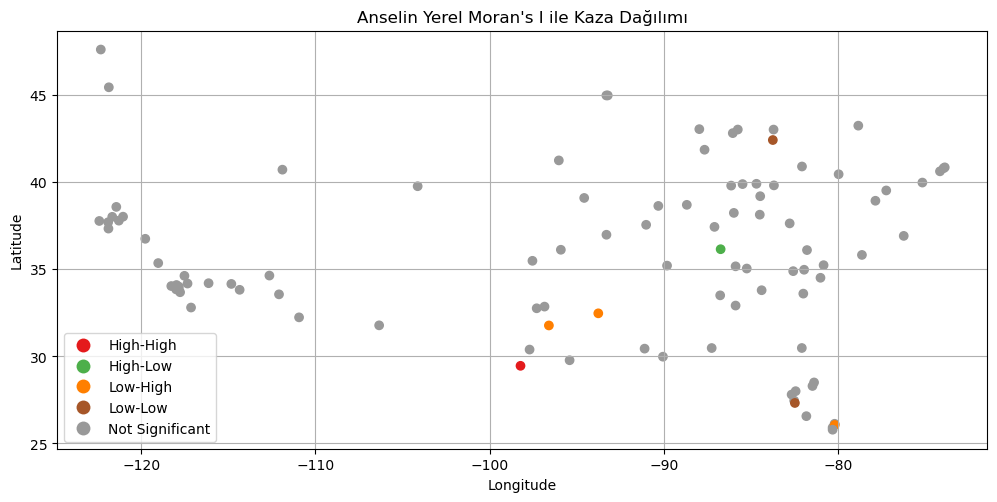

In [59]:
gdf, ax = anselin_morans_i_analysis(
    df=df,
    city_column='City',
    lat_column='Start_Lat',
    lng_column='Start_Lng',
    top_n=100,
    figsize=(12, 8)
)

In [61]:
def anselin_morans_i_analysis(df, city_column, lat_column, lng_column, figsize=(10, 8)):
    """
    Perform Anselin Local Moran's I analysis on all cities in the dataset and visualize the results.
    Veri setindeki tüm şehirlerde Anselin Yerel Moran's I analizini gerçekleştirir ve sonuçları görselleştirir.

    Parameters:
    - df (DataFrame): Input dataset containing accident data / Kaza verilerini içeren veri seti.
    - city_column (str): Column name for cities / Şehirlerin sütun adı.
    - lat_column (str): Column name for latitude / Enlemin sütun adı.
    - lng_column (str): Column name for longitude / Boylamın sütun adı.
    - figsize (tuple): Size of the output plot / Çıktı grafiğinin boyutu.

    Returns:
    - gdf (GeoDataFrame): GeoDataFrame with calculated categories / Hesaplanmış kategorilerle GeoDataFrame.
    - ax: Matplotlib axis object / Matplotlib eksen nesnesi.
    """
    # Şehir bazında merkez koordinatlarını hesaplayın
    city_coords = df.groupby(city_column).agg({
        lat_column: 'mean',
        lng_column: 'mean',
        city_column: 'count'
    }).rename(columns={city_column: 'Accident_Count'}).reset_index()

    # GeoDataFrame oluştur
    gdf = gpd.GeoDataFrame(
        city_coords,
        geometry=gpd.points_from_xy(city_coords[lng_column], city_coords[lat_column])
    )

    # Komşuluk matrisi oluştur (Queen contiguity)
    w = Queen.from_dataframe(gdf)
    w.transform = 'r'

    # Anselin Yerel Moran's I hesaplama
    moran_loc = Moran_Local(gdf['Accident_Count'], w)

    # Kategoriler ekle: High-High, Low-Low, Low-High, High-Low
    categories = np.array(['Not Significant'] * len(moran_loc.p_sim))
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 1)] = 'High-High'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 3)] = 'Low-Low'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 2)] = 'Low-High'
    categories[(moran_loc.p_sim < 0.05) & (moran_loc.q == 4)] = 'High-Low'

    gdf['Category'] = categories

    # Harita görselleştirme
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    gdf.plot(column='Category', categorical=True, legend=True, cmap='Set1', ax=ax)
    plt.title("Anselin Yerel Moran's I ile Kaza Dağılımı")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid(True)
    plt.show()

    return gdf, ax

C:\Users\hasan\AppData\Local\Temp\ipykernel_21224\3710448967.py:31: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w = Queen.from_dataframe(gdf)


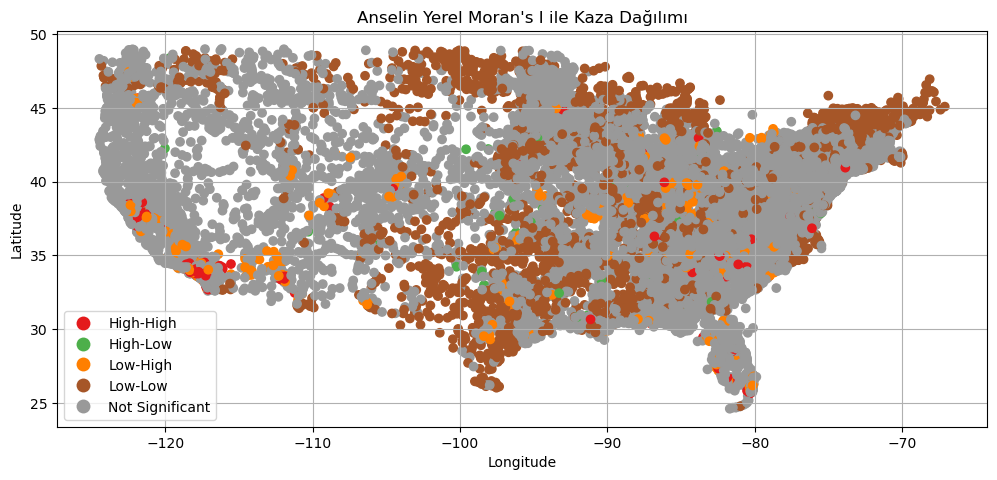

In [63]:
gdf, ax = anselin_morans_i_analysis(
    df=df,
    city_column='City',
    lat_column='Start_Lat',
    lng_column='Start_Lng',
    figsize=(12, 8)
)

In [71]:
from folium.plugins import MarkerCluster

In [89]:
def visualize_on_map(gdf, city_column, zoom_start=5):
    """
    Visualize the Anselin Local Moran's I categories on an interactive map.
    Anselin Yerel Moran's I kategorilerini etkileşimli bir harita üzerinde görselleştirir.

    Parameters:
    - gdf (GeoDataFrame): GeoDataFrame with Moran's I categories / Moran's I kategorilerini içeren GeoDataFrame.
    - city_column (str): Column name for cities / Şehirlerin sütun adı.
    - zoom_start (int): Initial zoom level for the map / Haritanın başlangıç yakınlaştırma seviyesi.

    Returns:
    - folium.Map: An interactive map / Etkileşimli bir harita.
    """
    # Haritanın merkezini belirlemek için GeoDataFrame'in ortalamasını al
    center_lat = gdf.geometry.y.mean()
    center_lon = gdf.geometry.x.mean()

    # Folium haritası oluştur
    m = folium.Map(location=[center_lat, center_lon], zoom_start=zoom_start, tiles='CartoDB positron')

    # Renklerin kategorilere göre atanması
    color_mapping = {
        "High-High": "red",
        "Low-Low": "blue",
        "High-Low": "green",
        "Low-High": "orange",
        "Not Significant": "gray"
    }

    # MarkerCluster kullanarak noktaları kümelendir
    marker_cluster = MarkerCluster().add_to(m)

    # Her noktayı haritaya ekle
    for _, row in gdf.iterrows():
        folium.CircleMarker(
            location=[row.geometry.y, row.geometry.x],  # Enlem ve boylam
            radius=6,  # Noktanın boyutu
            color=color_mapping[row['Category']],  # Kategoriye göre renk
            fill=True,
            fill_color=color_mapping[row['Category']],
            fill_opacity=0.7,
            popup=folium.Popup(f"City: {row[city_column]}<br>Category: {row['Category']}", max_width=200)
        ).add_to(marker_cluster)

    return m

In [91]:
interactive_map = visualize_on_map(gdf, city_column='City')  # city_column parametresini burada belirtin
interactive_map.save("interactive_map.html")  # Haritayı HTML olarak kaydedebilirsiniz
interactive_map  # Jupyter Notebook'ta haritayı görüntülemek için

In [93]:
from shapely.geometry import Point
from shapely.affinity import scale, rotate

In [95]:
def calculate_standard_ellipse(df, lat_column, lng_column):
    """
    Calculate the standard deviational ellipse for a set of geographic points.
    Coğrafi noktalar için standart sapma elipsini hesaplar.

    Parameters:
    - df (DataFrame): Data containing geographic coordinates / Coğrafi koordinatları içeren veri seti.
    - lat_column (str): Latitude column name / Enlem sütunu adı.
    - lng_column (str): Longitude column name / Boylam sütunu adı.

    Returns:
    - ellipse (shapely.geometry.Polygon): Standard deviational ellipse / Standart sapma elipsi.
    """
    # Ortalama merkezi hesapla
    mean_x = df[lng_column].mean()
    mean_y = df[lat_column].mean()

    # Standart sapmaları hesapla
    std_x = df[lng_column].std()
    std_y = df[lat_column].std()

    # Yönelim açısını hesapla (varsayılan olarak kuzeye paralel)
    angle = 0  # Açıyı daha karmaşık analizlerde PCA ile hesaplayabilirsiniz.

    # Elipsi oluştur
    ellipse = Point(mean_x, mean_y).buffer(1)  # Elips için birim bir çember oluştur
    ellipse = scale(ellipse, std_x, std_y)  # Standart sapmalarla ölçeklendir
    ellipse = rotate(ellipse, angle)  # Yönelim açısına göre döndür

    return ellipse

In [97]:
def plot_spatial_orientation(df, lat_column, lng_column, figsize=(12, 8)):
    """
    Visualize spatial orientation analysis with a standard deviational ellipse.
    Standart sapma elipsi ile mekansal yönelim analizini görselleştirir.

    Parameters:
    - df (DataFrame): Data containing geographic coordinates / Coğrafi koordinatları içeren veri seti.
    - lat_column (str): Latitude column name / Enlem sütunu adı.
    - lng_column (str): Longitude column name / Boylam sütunu adı.
    - figsize (tuple): Size of the output plot / Çıktı grafiğinin boyutu.

    Returns:
    - ax: Matplotlib axis object / Matplotlib eksen nesnesi.
    """
    # GeoDataFrame oluştur
    gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df[lng_column], df[lat_column])
    )

    # Standart sapma elipsini hesapla
    ellipse = calculate_standard_ellipse(df, lat_column, lng_column)

    # Haritayı görselleştir
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    gdf.plot(ax=ax, color='blue', markersize=5, label='Kazalar')
    gpd.GeoSeries([ellipse]).plot(ax=ax, color='red', alpha=0.3, edgecolor='black', label='Standart Merkezi Elips')
    plt.title("Mekansal Yönelim Analizi ile Kaza Dağılım Haritası")
    plt.xlabel("Longitude (Boylam)")
    plt.ylabel("Latitude (Enlem)")
    plt.legend()
    plt.grid(True)
    plt.show()

    return ax

C:\Users\hasan\AppData\Local\Temp\ipykernel_21224\2620482879.py:31: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
C:\Users\hasan\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


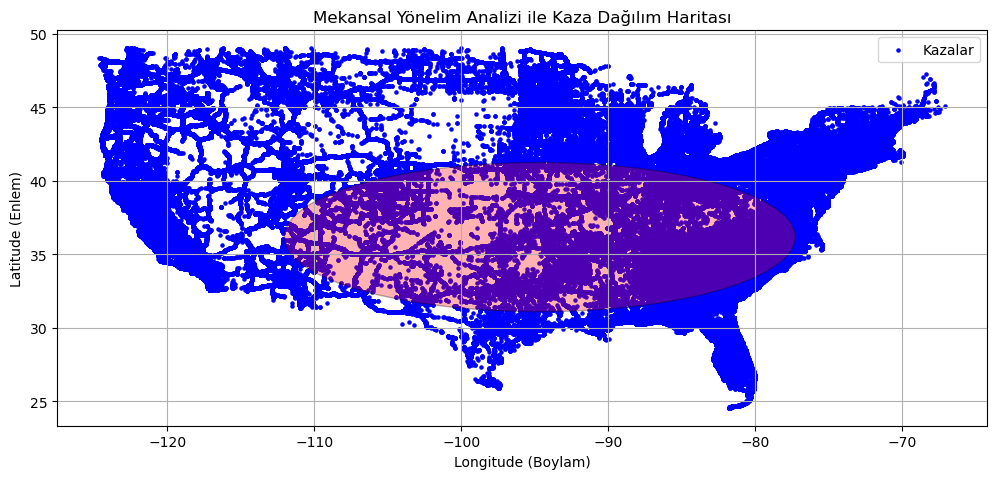

<Axes: title={'center': 'Mekansal Yönelim Analizi ile Kaza Dağılım Haritası'}, xlabel='Longitude (Boylam)', ylabel='Latitude (Enlem)'>

In [99]:
plot_spatial_orientation(df, lat_column='Start_Lat', lng_column='Start_Lng')